In [1]:
import cv2
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import numpy as np
from skimage import data

from tensorflow.keras import Input, Model
from tensorflow.python.keras import applications
from tensorflow.keras import losses, metrics, optimizers
from tensorflow.keras import layers, Sequential

from skimage.metrics import peak_signal_noise_ratio, structural_similarity

## 프로젝트 1-1

In [2]:
image_path = os.getenv('HOME') + '/mini_projects/_E-16_srgan/tiger.jpg'
original_image = cv2.imread(image_path)
image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

오리지널 이미지크기 :  (640, 1024, 3)


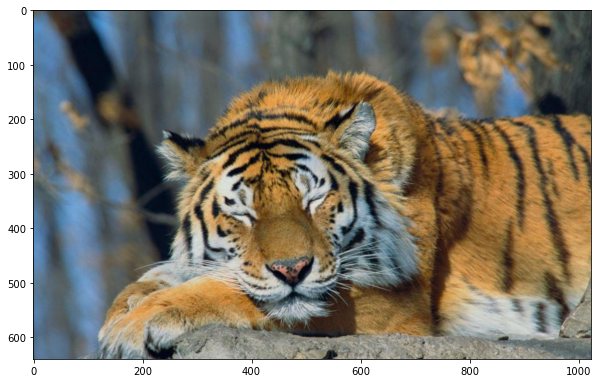

In [5]:
original_shape = image.shape
print('오리지널 이미지크기 : ', original_shape)

plt.figure(figsize=(10,10))
plt.imshow(image)

1/4 축소

(160, 256, 3)


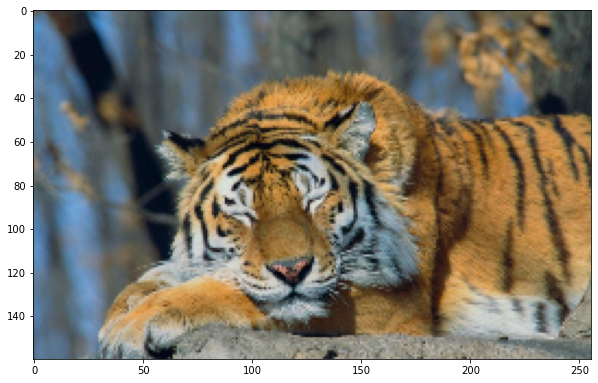

In [7]:
lr_image = cv2.resize(image, dsize=(256,160)) # (가로 픽셀 수, 세로 픽셀 수)

print(lr_image.shape)

plt.figure(figsize=(10,10))
plt.imshow(lr_image)

bicubic interpolation

In [11]:
bicubic_image = cv2.resize(
    lr_image, 
    dsize=(1024, 640), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC) # bicubic interpolation 적용


SRGAN 적용

In [2]:
model_file = os.getenv('HOME')+'/mini_projects/_E-16_srgan/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [12]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

srgan_hr = apply_srgan(lr_image)

시각화

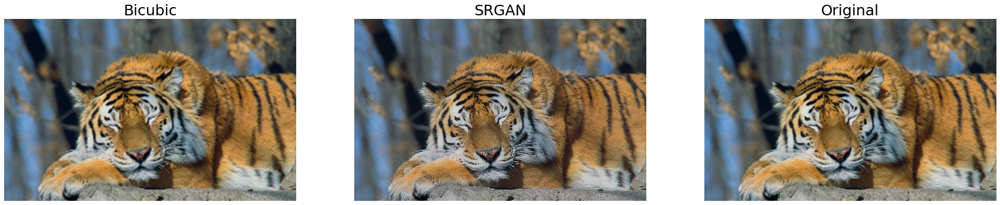

In [14]:
images = [bicubic_image, srgan_hr, image]
titles = ["Bicubic", "SRGAN", "Original"]

plt.figure(figsize=(30,10))

for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=25)
    plt.axis('off')

상세 비교

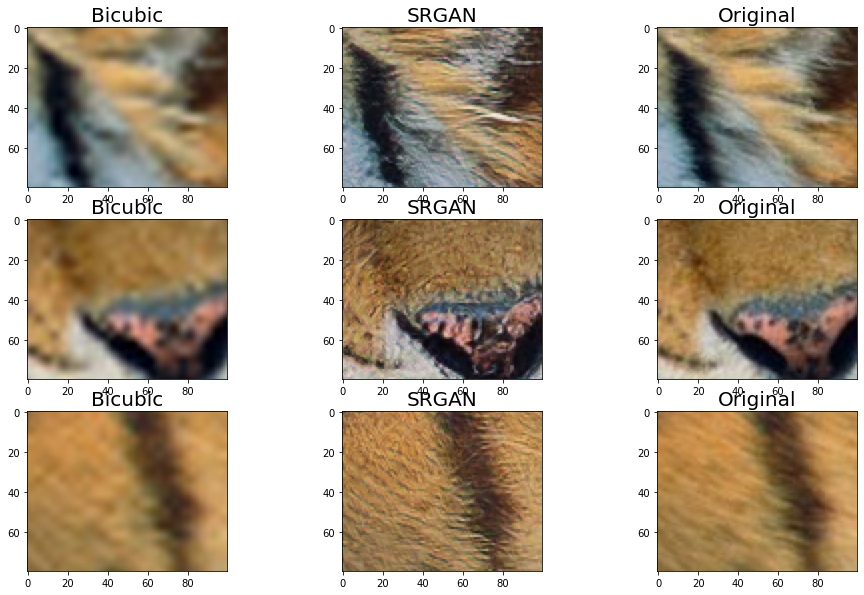

In [34]:
# 특정 영역을 잘라낼 함수를 정의합니다.
def crop(image, left_top, x=80, y=100):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]


# 잘라낼 영역의 좌표를 정의합니다.
left_tops = [(300,600)] *3 + [(420,400)] *3 + [(400,900)] *3

plt.figure(figsize=(16,10))
for i, (image, left_top, title) in enumerate(zip(images*3, left_tops, titles*3)):
    plt.subplot(3,3,i+1)
    plt.imshow(crop(image, left_top))
    plt.title(title, fontsize=20)

SRGAN 이 원본이미지보다 더 선명해졌지만, 자연스러움은 줄어든 느낌이다

## 프로젝트 1-2

In [3]:
image_path = os.getenv('HOME') + '/mini_projects/_E-16_srgan/wolf.jpg'
original_image = cv2.imread(image_path)
image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

오리지널 이미지크기 :  (721, 497, 3)


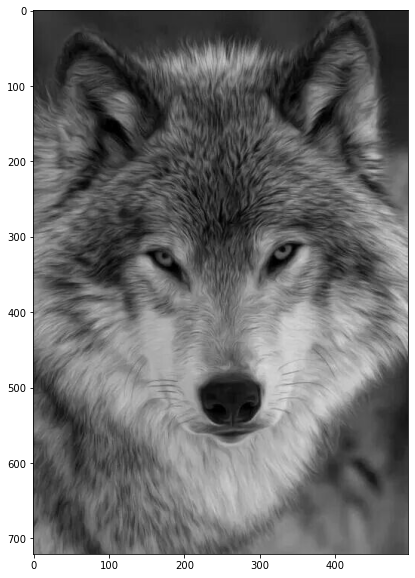

In [6]:
original_shape = image.shape
print('오리지널 이미지크기 : ', original_shape)

plt.figure(figsize=(10,10))
plt.imshow(image)

1/4 축소

(180, 124, 3)


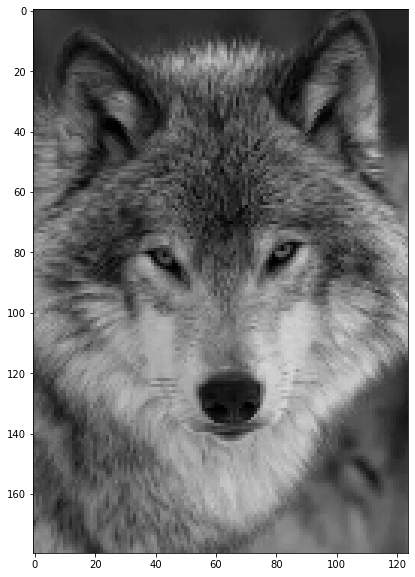

In [8]:
lr_image = cv2.resize(image, dsize=(124,180)) # (가로 픽셀 수, 세로 픽셀 수)

print(lr_image.shape)

plt.figure(figsize=(10,10))
plt.imshow(lr_image)

bicubic interpolation

In [13]:
bicubic_image = cv2.resize(
    lr_image, 
    dsize=(497, 721), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC) # bicubic interpolation 적용

SRGAN적용

In [14]:
model_file = os.getenv('HOME')+'/mini_projects/_E-16_srgan/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [15]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

srgan_hr = apply_srgan(lr_image)

시각화

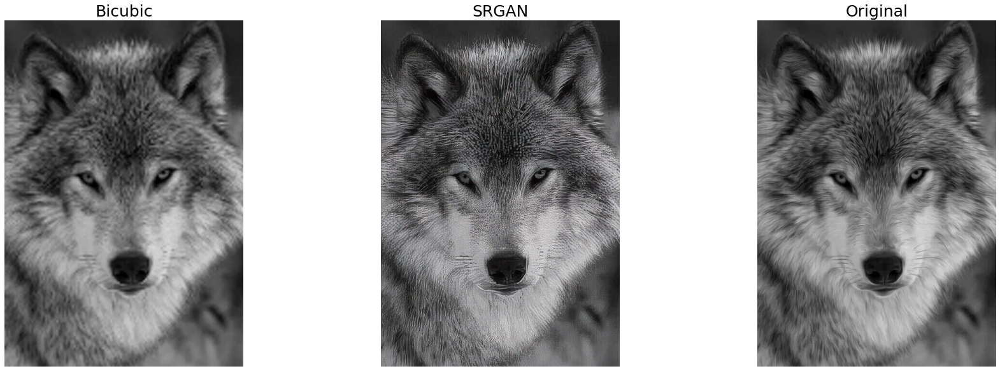

In [16]:
images = [bicubic_image, srgan_hr, image]
titles = ["Bicubic", "SRGAN", "Original"]

plt.figure(figsize=(30,10))

for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=25)
    plt.axis('off')

상세비교

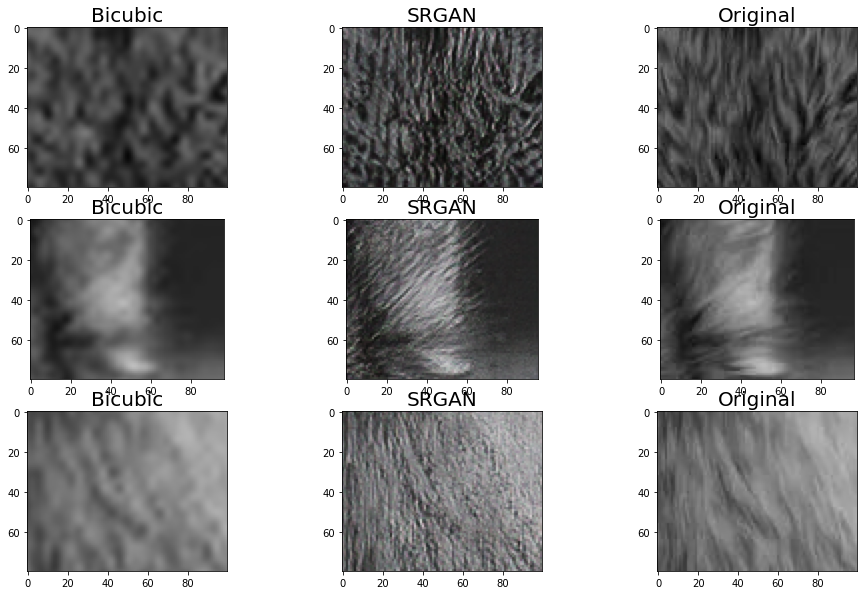

In [18]:
# 특정 영역을 잘라낼 함수를 정의합니다.
def crop(image, left_top, x=80, y=100):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]


# 잘라낼 영역의 좌표를 정의합니다.
left_tops = [(150,200)] *3 + [(120,400)] *3 + [(600,120)] *3

plt.figure(figsize=(16,10))
for i, (image, left_top, title) in enumerate(zip(images*3, left_tops, titles*3)):
    plt.subplot(3,3,i+1)
    plt.imshow(crop(image, left_top))
    plt.title(title, fontsize=20)

저해상도로 비교했을 때 SRGAN과 오리지널의 차이를 더 분명히 알 수 있다. 선명함이 아니라 밀도가 낮다는 걸 볼 수 있다.

# 프로젝트 2

### 1. gif파일 불러오기

In [19]:
# 다운받은 파일의 경로를 설정해 주세요.
gif_path = os.getenv("HOME") + '/mini_projects/_E-16_srgan/book_lr.gif'
gif = cv2.VideoCapture(gif_path)

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 22
frame 크기 : (215, 380, 3)


### 2. 프레임별 SR 진행하기 (bicubic)

In [21]:
frames_sr = []
for i in range(len(frames)):
    bicubic_image = cv2.resize(
    frames[i], 
    dsize=(860, 1520), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
)

    frames_sr.append(bicubic_image)


In [26]:
import imageio

imageio.mimsave("book_hr.gif", frames_sr)

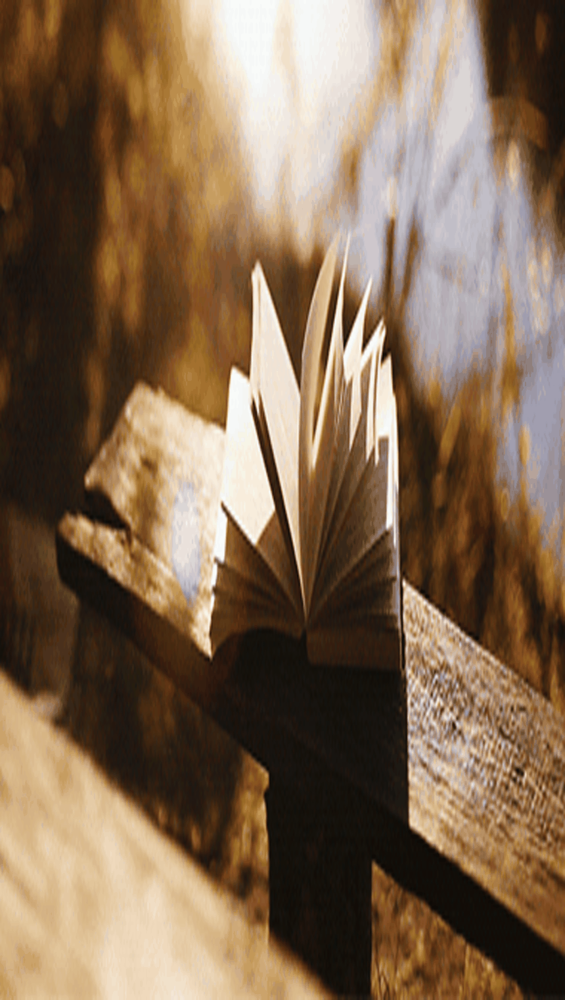

In [29]:
from IPython.display import Image as show_gif

show_gif("book_hr.gif", width=300) # width 는 적당히 큰 값으로 설정해주세요

### 3. 프레임별 SR 진행하기 (SRGAN)

In [38]:
def apply_srgan(image):
    gif = []
    for i in range(len(image)):
        image[i] = tf.cast(image[i][np.newaxis, ...], tf.float32)
        sr = srgan.predict(image[i])
        sr = tf.clip_by_value(sr, 0, 255)
        sr = tf.round(sr)
        sr = tf.cast(sr, tf.uint8)
        gif.append(sr)

    return np.array(gif).reshape(22, 860, 1520, 3)
frames_srgan = apply_srgan(frames)

ValueError: in user code:

    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1147 predict_function  *
        outputs = self.distribute_strategy.run(
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:951 run  **
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2290 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2649 _call_for_each_replica
        return fn(*args, **kwargs)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1122 predict_step  **
        return self(x, training=False)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer.py:927 __call__
        outputs = call_fn(cast_inputs, *args, **kwargs)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/network.py:719 call
        convert_kwargs_to_constants=base_layer_utils.call_context().saving)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/network.py:888 _run_internal_graph
        output_tensors = layer(computed_tensors, **kwargs)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer.py:886 __call__
        self.name)
    /home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/tensorflow/python/keras/engine/input_spec.py:180 assert_input_compatibility
        str(x.shape.as_list()))

    ValueError: Input 0 of layer conv2d_26 is incompatible with the layer: expected ndim=4, found ndim=10. Full shape received: [None, 1, 1, 1, 1, 1, 1, 215, 380, 3]


# 회고

프로젝트 2는 막힌 상태에서 더 나아가지 못했다.   
사실  SR이 좋은 건지 모르겠다.   
난 눈이 나빠 안경을 써야 멀리 있는 게 잘 보이는데   
일부러 안쓰고 나갈때가 많다.   
세상이 뿌옇게 보이면 또렷했을 때보다 더 아름다워 보인다.   
이 기술이 훗날 인공안구개발에 중요한 성능의 한 축을 담당할지도 모른다는 생각이 든다   